# Pillow
Darbas su nuotraukomis

#### .show() nuskaityti ir atvaizduoti ekrane paveiksliuka

In [2]:
# darbas su python PIL biblioteka. Jei nera, isidiegti pip install Pillow
# paveiksliukos nuskaitymas ir atvaizdavimas ekrane .show()
from PIL import Image

dogas = Image.open("image/dog.jpg")
# atidaro su standartine paveiksliuku perziuros programa
dogas.show()

#### .save() nuotraukos issaugojimas kitu pavadinimu

In [3]:
# issaugom kopija, kitu pavadinimu
dogas.save("image/funny_dog.jpg")

#### .format, .size, .mode

In [4]:
print(dogas.format)
print(dogas.size)
print(dogas.mode)

JPEG
(428, 570)
RGB


#### .thumbnail padaro paveikslelio miniatiura, t.y. sumazina

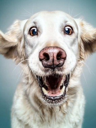

In [5]:
# svarbu cia padaryti .copy(), nes kitaip originala padarys maziuka
size = 128, 128
maziukas = dogas.copy()
maziukas.thumbnail(size)
maziukas

#### .crop iskerpa

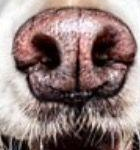

In [6]:
# box = 150, 200, 300, 350
# nosis = dogas.crop(box)
# nosis

# Koordinačių sistemos pradžia (0,0) yra paveikslėlio viršutiniame-kairiame kampe. 
# jei nori vienoj eilutej, su tuple. kaip karposi, nuo kur pradzia (pvz kaip destytojop 375,450,650,725), [left, up, right, bottom] of the image to crop
nosis = dogas.crop((160, 200, 300, 350))
nosis

#### .transpose vertalioja paveiksliuka

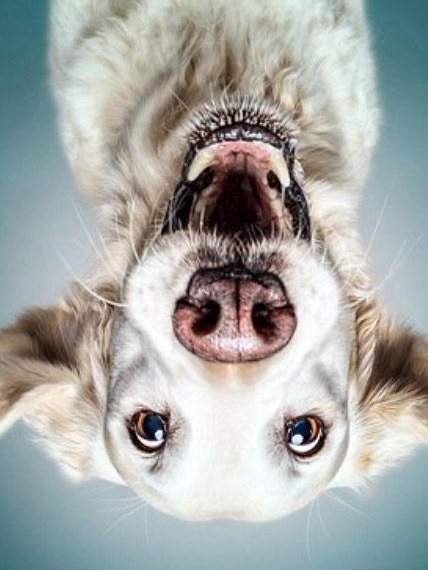

In [7]:
dogas.transpose(Image.Transpose.FLIP_TOP_BOTTOM)

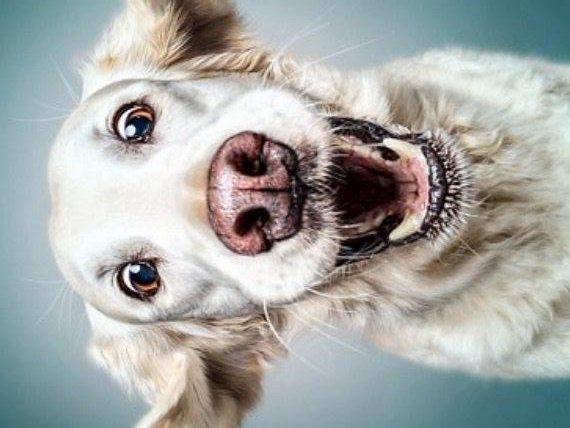

In [8]:
dogas.transpose(Image.Transpose.ROTATE_90)

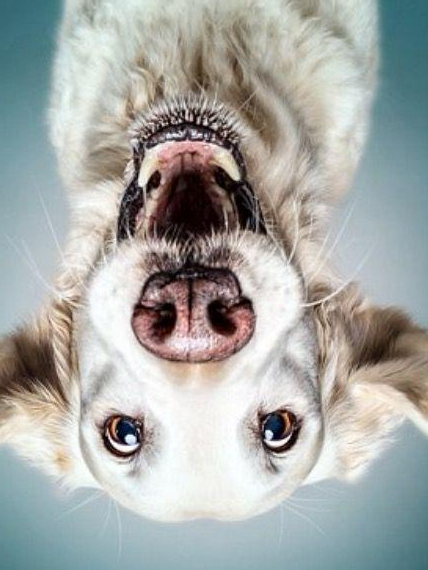

In [9]:
dogas.transpose(Image.Transpose.ROTATE_180)

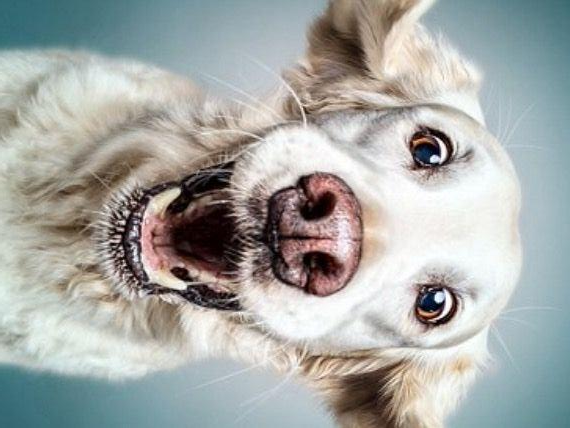

In [10]:
dogas.transpose(Image.Transpose.ROTATE_270)

#### .resize() pakeicia dydi pagal nurodytas reiksmes

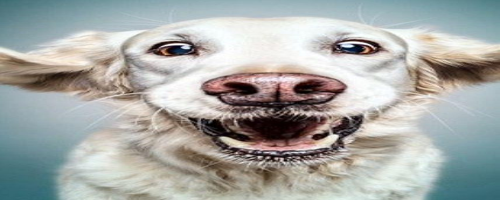

In [11]:
# resize eina su tuple 
platus = dogas.resize((500, 200))
platus

#### .paste() ant nuotraukos uždeda kitą nuotrauką

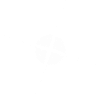

In [12]:
zvaigzde = Image.open("image/imgbin_white-shining-stars.png")
zvaigzdute = zvaigzde.resize((100, 100))
zvaigzdute

In [13]:
zvaigzdute.size

(100, 100)

In [14]:
zvaigzdute.mode

'RGBA'

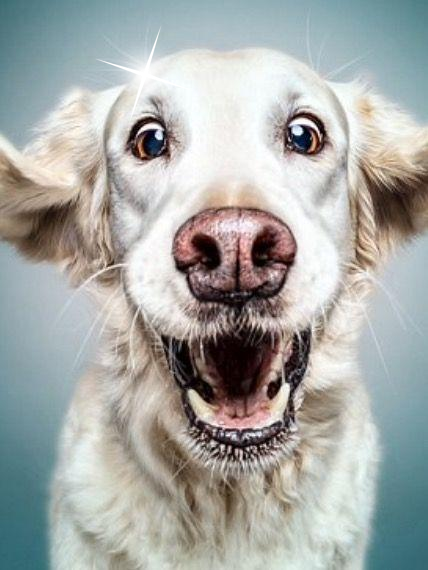

In [15]:
# apsibreziam zvaigzdes pozicija ant kopijuojamo paveiksliuko
# 95x25 - kairys virsutinis kampas, 95+plotis ant 25+auktis - desinys apatinis kampas
zvaigzdutes_lokacija = (95, 25, 95+zvaigzdute.size[0], 25+zvaigzdute.size[1])
# pasidarom (del visa ko) kopija is "originalo"
dogas_copy = dogas.copy()
# i kopija idedam zvaigzdute, pagal nurodytas koordinates. 3 parametras yra ALPHA mask (jo reikia tik permatomiems paveiksliukams)
dogas_copy.paste(zvaigzdute, zvaigzdutes_lokacija, zvaigzdute)
# rezultatas
dogas_copy

#### filter

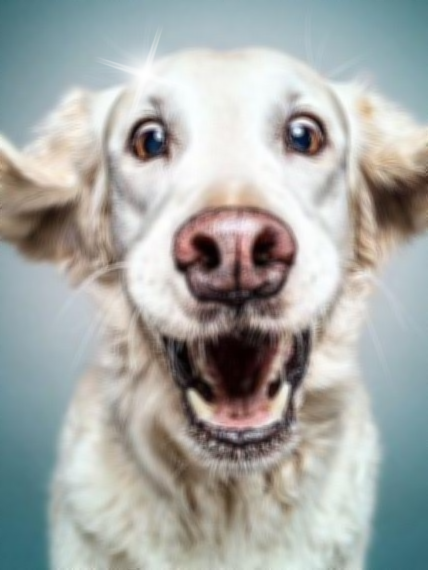

In [16]:
# filtrai. Jei nera, reikia papildomai importuoti ImageFilter modulį.
# BLUR, CONTOUR, DETAIL, EDGE_ENHANCE, EDGE_ENHANCE_MORE, EMBOSS, FIND_EDGES, SMOOTH, SMOOTH_MORE, SHARPEN.
from PIL import ImageFilter
su_efektu = dogas_copy.filter(ImageFilter.BLUR)
su_efektu


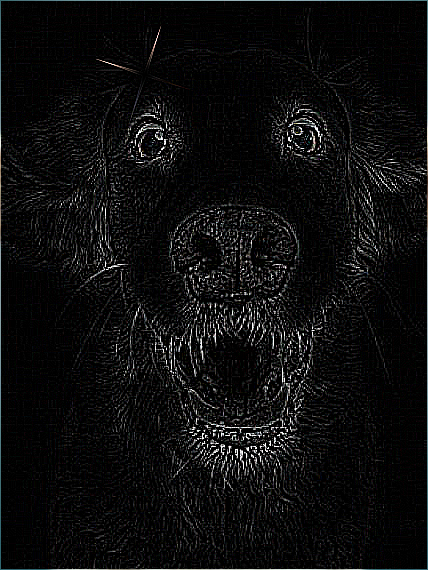

In [17]:
su_efektu = dogas_copy.filter(ImageFilter.FIND_EDGES)
su_efektu

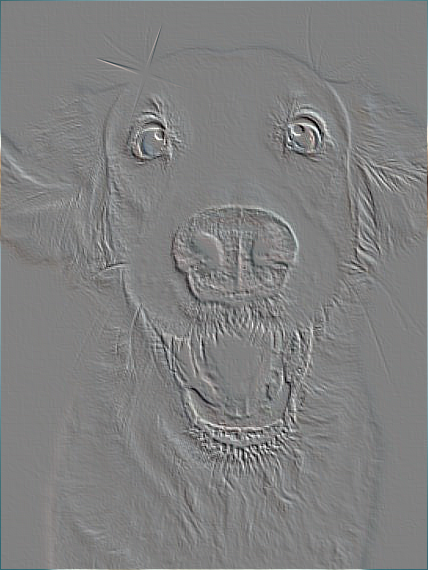

In [18]:
su_efektu = dogas_copy.filter(ImageFilter.EMBOSS)
su_efektu

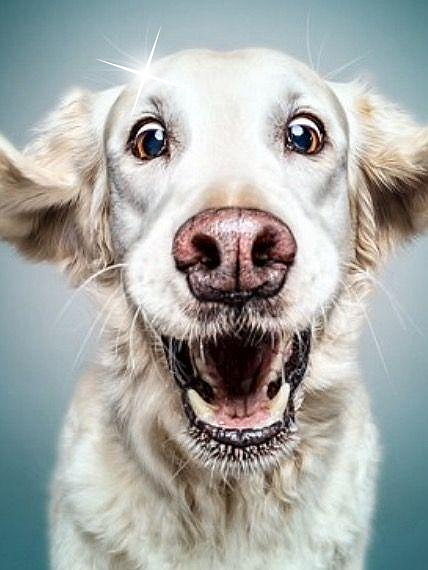

In [19]:
su_efektu = dogas_copy.filter(ImageFilter.DETAIL)
su_efektu

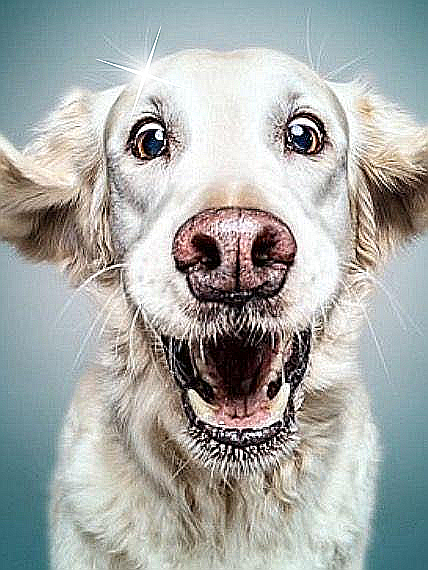

In [20]:
su_efektu = dogas_copy.filter(ImageFilter.EDGE_ENHANCE)
su_efektu


#### .getdata()  sukuria objektą, kuriame saugomos visos pikselių reikšmės

In [21]:
pixeldata = su_efektu.getdata()
print(su_efektu.size)
for pixel in enumerate(pixeldata):
    print(pixel)

(428, 570)
(0, (58, 105, 111))
(1, (59, 106, 112))
(2, (61, 108, 114))
(3, (60, 107, 113))
(4, (59, 106, 112))
(5, (59, 106, 112))
(6, (61, 108, 114))
(7, (62, 109, 115))
(8, (64, 111, 117))
(9, (64, 111, 117))
(10, (65, 112, 118))
(11, (65, 112, 118))
(12, (66, 113, 119))
(13, (67, 114, 120))
(14, (68, 115, 121))
(15, (70, 115, 121))
(16, (71, 114, 121))
(17, (73, 113, 121))
(18, (74, 114, 122))
(19, (75, 115, 123))
(20, (77, 117, 125))
(21, (78, 118, 126))
(22, (79, 119, 127))
(23, (79, 119, 127))
(24, (78, 118, 126))
(25, (78, 118, 126))
(26, (78, 118, 126))
(27, (79, 119, 127))
(28, (79, 119, 127))
(29, (79, 119, 127))
(30, (80, 120, 128))
(31, (80, 120, 128))
(32, (81, 121, 129))
(33, (81, 121, 129))
(34, (83, 123, 131))
(35, (84, 124, 132))
(36, (85, 125, 133))
(37, (86, 126, 134))
(38, (86, 126, 134))
(39, (86, 126, 134))
(40, (85, 125, 133))
(41, (86, 126, 134))
(42, (87, 127, 135))
(43, (88, 128, 136))
(44, (89, 129, 137))
(45, (89, 129, 137))
(46, (89, 129, 137))
(47, (89, 12

#### .putdata() leidžia pakeisti paveikslėlio pikselius kitomis reikšmėmis

In [22]:
# nuo 0 iki 255 reiksme. Kuo didesnis skaicius tuo sviesiau.
new_pixels = [(abs(new[0] - 30), abs(new[1] + 50), abs(new[2] - 30)) for new in pixeldata]
for pixel in enumerate(new_pixels):
    print(pixel)

(0, (28, 155, 81))
(1, (29, 156, 82))
(2, (31, 158, 84))
(3, (30, 157, 83))
(4, (29, 156, 82))
(5, (29, 156, 82))
(6, (31, 158, 84))
(7, (32, 159, 85))
(8, (34, 161, 87))
(9, (34, 161, 87))
(10, (35, 162, 88))
(11, (35, 162, 88))
(12, (36, 163, 89))
(13, (37, 164, 90))
(14, (38, 165, 91))
(15, (40, 165, 91))
(16, (41, 164, 91))
(17, (43, 163, 91))
(18, (44, 164, 92))
(19, (45, 165, 93))
(20, (47, 167, 95))
(21, (48, 168, 96))
(22, (49, 169, 97))
(23, (49, 169, 97))
(24, (48, 168, 96))
(25, (48, 168, 96))
(26, (48, 168, 96))
(27, (49, 169, 97))
(28, (49, 169, 97))
(29, (49, 169, 97))
(30, (50, 170, 98))
(31, (50, 170, 98))
(32, (51, 171, 99))
(33, (51, 171, 99))
(34, (53, 173, 101))
(35, (54, 174, 102))
(36, (55, 175, 103))
(37, (56, 176, 104))
(38, (56, 176, 104))
(39, (56, 176, 104))
(40, (55, 175, 103))
(41, (56, 176, 104))
(42, (57, 177, 105))
(43, (58, 178, 106))
(44, (59, 179, 107))
(45, (59, 179, 107))
(46, (59, 179, 107))
(47, (59, 179, 107))
(48, (59, 179, 109))
(49, (59, 179, 

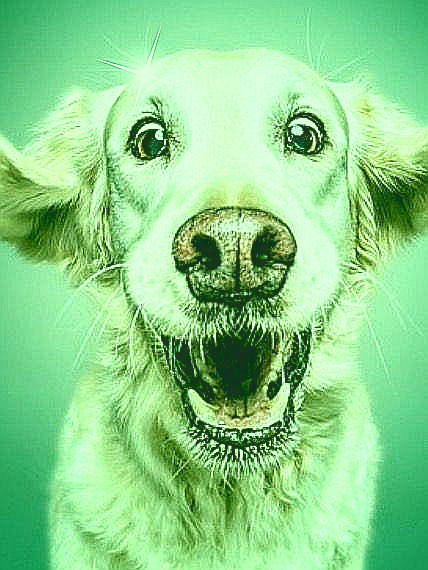

In [23]:
zalias_suo = su_efektu.copy()
zalias_suo.putdata(new_pixels)
zalias_suo

#### .convert() Konverteris tarp "RGB", "RGBA", "L"(juoda-balta), "1"(1-bit pixels), "P"(8-bit pixels) ir daug kitų nuotraukų tipų.

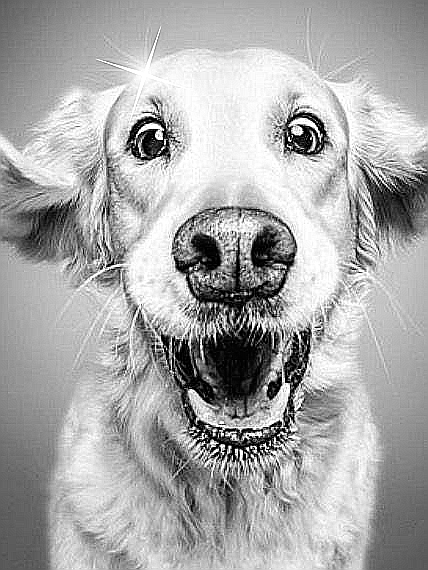

In [24]:
# black and white. Konverteris tarp "RGB", "RGBA", "L"(juoda-balta), ir daug kitų nuotraukų tipų
bw_dogas = su_efektu.convert("L")
bw_dogas

#### ImageEnchance modulis papildomai importavus ImageEnchance, galime reguliuoti kontrasta .Contrast(), spalvinguma .Color, astruma .Sharpness, ryskuma .Brightness

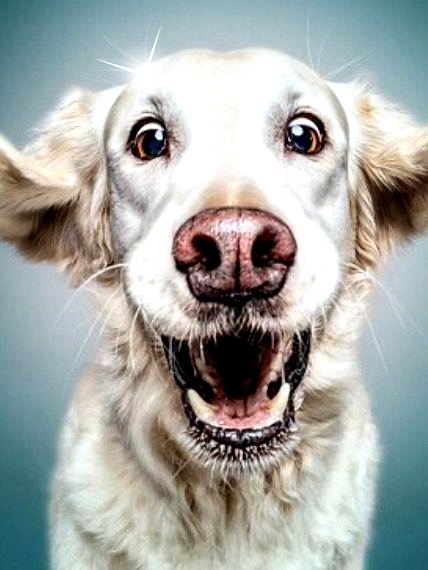

In [25]:
from PIL import ImageEnhance
ryskiai = ImageEnhance.Contrast(dogas_copy)
ryskiai.enhance(1.2)

In [26]:
ryskiai.enhance(1.3).save('image/test.png')

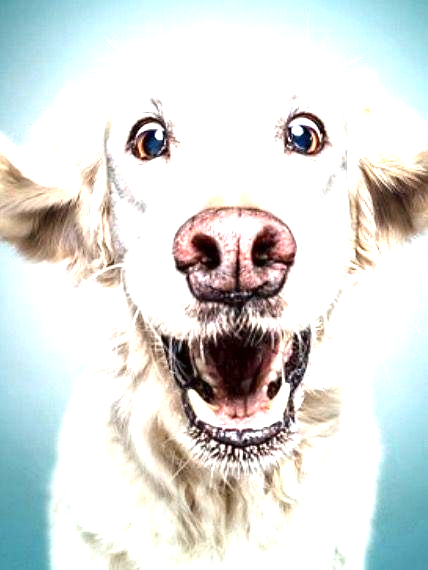

In [27]:
sviesiai = ImageEnhance.Brightness(dogas_copy)
sviesiai.enhance(1.5)

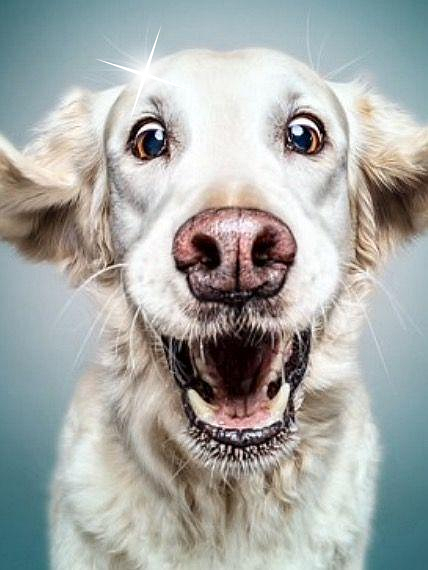

In [28]:
astrus = ImageEnhance.Sharpness(dogas_copy)
astrus.enhance(1.5)

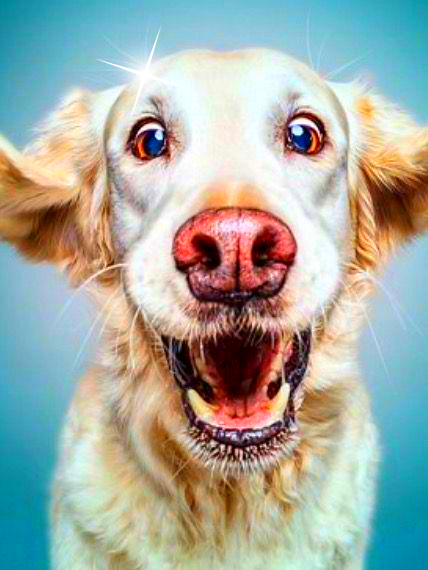

In [29]:
spalvingumas = ImageEnhance.Color(dogas_copy)
spalvingumas.enhance(3)

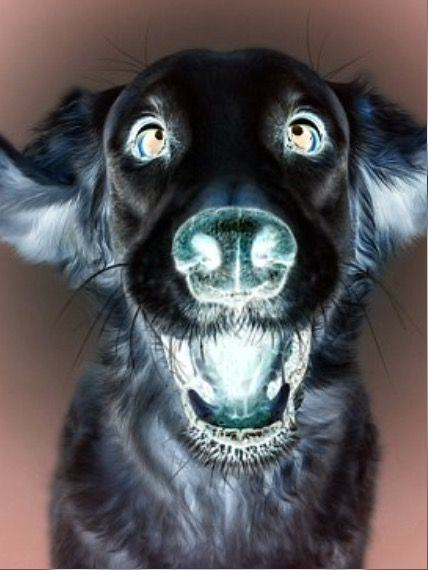

In [30]:
for i in range(0, dogas.size[0]-1):
    for j in range(0, dogas.size[1]-1):
        pixelColorVals = dogas.getpixel((i, j))
        redPixel= 255 - pixelColorVals[0]
        greenPixel= 255 - pixelColorVals[1]
        bluePixel= 255 - pixelColorVals[2]
        dogas.putpixel((i,j),(redPixel, greenPixel, bluePixel))
dogas

#### Testing

In [31]:
inga = Image.open("image/Capture.JPG")
inga.show()

In [32]:
inga.size

(570, 754)

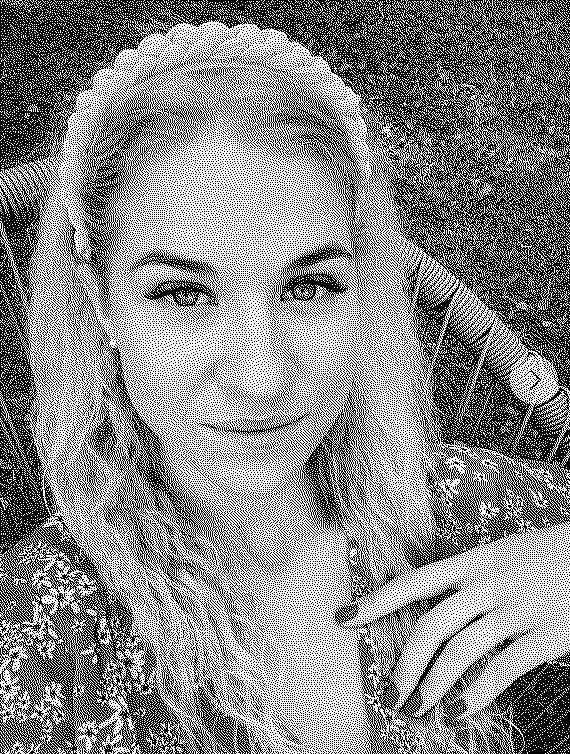

In [33]:
inga_bw = inga.convert("1")
inga_bw

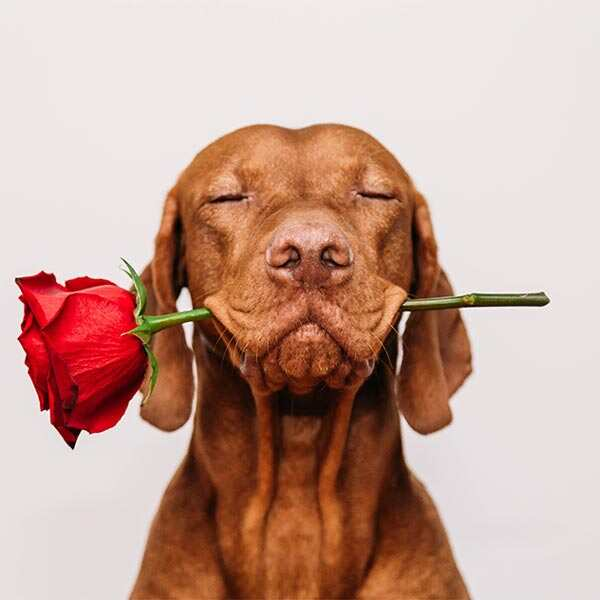

In [34]:
brown = Image.open("image/prim123.jpg")
brown

In [35]:
print(brown.size)
print(brown.mode)

(600, 600)
RGB


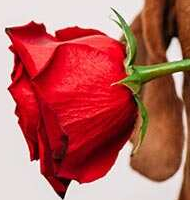

In [36]:
roze = brown.crop((10, 250, 200, 450))
roze

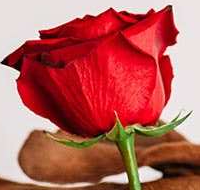

In [37]:
roze.transpose(Image.Transpose.ROTATE_270)

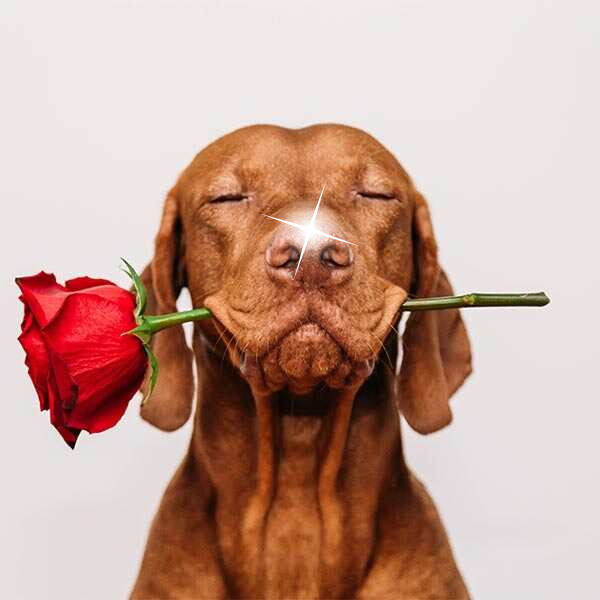

In [38]:
zvaigzdutes_lokacija = (260, 180, 260+zvaigzdute.size[0], 180+zvaigzdute.size[1])
brown_copy = brown.copy()
brown_copy.paste(zvaigzdute, zvaigzdutes_lokacija, zvaigzdute)
brown_copy